In [1]:
import torch
import torch.nn as nn
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from torch.distributions.normal import Normal
from torch.distributions.kl import kl_divergence
import torchvision.utils as vutils

import math
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import umap.umap_ as umap
import plotly.express as px
from tqdm import tqdm
import time
import random

## Set Up

In [2]:
def set_seed(seed_value=42):
    random.seed(seed_value)
    np.random.seed(seed_value)
    torch.manual_seed(seed_value)

In [3]:
set_seed()

In [4]:
device = 'cpu'
torch.device(device)

device(type='cpu')

## Dataset

In [5]:
transform = transforms.Compose([transforms.ToTensor()])

train_dataset = datasets.MNIST('./data', download=True, train=True, transform=transform) # (images [60000, 28, 28], labels [60000])
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True) # (images [937, 64, 1, 28, 28], labels [937, 64])

test_dataset = datasets.MNIST('./data', download=True, train=False, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=True)

In [6]:
images, labels = next(iter(train_loader))
print(images.shape, labels.shape)

torch.Size([64, 1, 28, 28]) torch.Size([64])


## Image Visualizations

In [7]:
def show_image(image, title='Sample Image'):
    plt.figure(figsize=(1,1))
    plt.imshow(image.permute(1, 2, 0).cpu().numpy().repeat(3, 2), cmap='gray')
    plt.title(title)
    plt.axis('off')

In [8]:
def show_images_grid(images, title='Sample Images Grid'):
    plt.figure(figsize=(7,7))
    grid = vutils.make_grid(images, nrow=images.shape[0]//2, padding=2, normalize=True).permute(1, 2, 0) # Convert chw to hwc
    plt.imshow(grid.cpu().numpy())
    plt.title(title)
    plt.axis('off')

In [9]:
def visualize_images_from_class(dataloader:torch.utils.data.dataloader.DataLoader, class_label:int, num_images=25):
    
    images_grid = []

    for images, labels in dataloader:
        for i in range(len(labels)):
            if labels[i] == class_label:
                images_grid.append(images[i])
                if len(images_grid) == num_images:
                    break
        if len(images_grid) == num_images:
            break
    
    if len(images_grid) < num_images:
        print(f'Only found {len(images_grid)} images belonging to {class_label}')
    
    images_grid = torch.stack(images_grid)[:num_images]
    show_images_grid(images_grid)

In [10]:
train_loader.dataset.class_to_idx

{'0 - zero': 0,
 '1 - one': 1,
 '2 - two': 2,
 '3 - three': 3,
 '4 - four': 4,
 '5 - five': 5,
 '6 - six': 6,
 '7 - seven': 7,
 '8 - eight': 8,
 '9 - nine': 9}

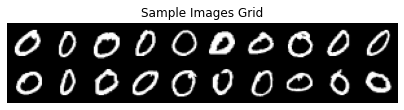

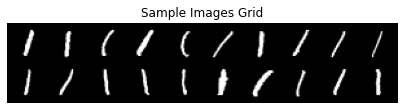

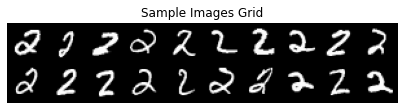

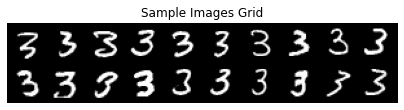

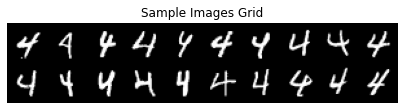

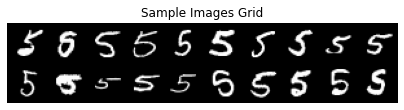

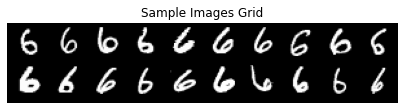

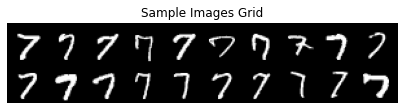

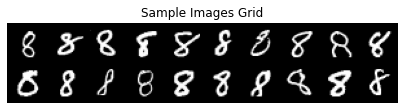

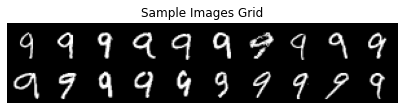

In [11]:
for class_name in train_loader.dataset.class_to_idx:
    visualize_images_from_class(train_loader, 
                                class_label=train_loader.dataset.class_to_idx[class_name], 
                                num_images=20)

## Modeling

In [12]:
class Encoder(nn.Module):

    def __init__(self, im_chan=1, output_chan=32, hidden_dim=16):
        super().__init__()
        self.z_dim = output_chan
        self.encoder = nn.Sequential(self.init_conv_block(im_chan, hidden_dim),
                                     self.init_conv_block(hidden_dim, hidden_dim * 2),
                                     self.init_conv_block(hidden_dim * 2, output_chan * 2, final_layer=True)) # double output channel dimensions for mean and std with size [output_chan]
        
    def init_conv_block(self, input_channels, output_channels, kernel_size=4, stride=2, padding=0, final_layer=False):
        layers = [nn.Conv2d(input_channels, output_channels, kernel_size=kernel_size, padding=padding, stride=stride)]
        if not final_layer:
            layers += [nn.BatchNorm2d(output_channels),
                       nn.ReLU(inplace=True)]
            
        return nn.Sequential(*layers)
    
    def forward(self, image:torch.Tensor):
        encoder_pred:torch.Tensor = self.encoder(image)
        encoding = encoder_pred.view(len(encoder_pred), -1)
        mean = encoding[:, :self.z_dim]
        logvar = encoding[:, self.z_dim:]
        std = torch.exp(logvar * 0.5)

        return mean, std

In [13]:
class Decoder(nn.Module):

    def __init__(self, z_dim=32, im_chan=1, hidden_dim=64):
        super().__init__()
        self.z_dim = z_dim
        self.decoder = nn.Sequential(self.init_conv_block(z_dim, hidden_dim * 4),
                                      self.init_conv_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
                                      self.init_conv_block(hidden_dim * 2, hidden_dim),
                                      self.init_conv_block(hidden_dim, im_chan, kernel_size=4, final_layer=1))
        
    def init_conv_block(self, input_channels, output_channels, kernel_size=3, stride=2, padding=0, final_layer=False):
        layers = [nn.ConvTranspose2d(input_channels, output_channels, kernel_size=kernel_size, padding=padding, stride=stride)]
        if not final_layer:
            layers += [nn.BatchNorm2d(output_channels),
                       nn.ReLU(inplace=True)]
        else:
            layers += [nn.Sigmoid()]
            
        return nn.Sequential(*layers)
    
    def forward(self, z:torch.Tensor):
        return self.decoder(z.view(-1, self.z_dim, 1, 1)) # Ensure z is shaped correctly before passing it through decoder

In [14]:
class VariationalAutoEncoder(nn.Module):

    def __init__(self, z_dim=32, im_chan=1):
        super().__init__()
        self.z_dim = z_dim
        self.encoder = Encoder(im_chan, z_dim)
        self.decoder = Decoder(z_dim, im_chan)

    def forward(self, images):
        z_dist = Normal(*self.encoder(images))
        z = z_dist.rsample() # Reparameterization trick
        decoding = self.decoder(z)
        return decoding, z_dist

In [15]:
def kl_divergence_loss(z_dist):
    return kl_divergence(z_dist, Normal(torch.zeros_like(z_dist.mean), torch.ones_like(z_dist.stddev))).sum(-1).sum()

In [16]:
reconstruction_loss = nn.BCELoss(reduction='sum')

In [17]:
def train_model(epochs=10, z_dim=16):
    model = VariationalAutoEncoder(z_dim=z_dim).to(device)
    optimizer = torch.optim.Adam(model.parameters())

    for epoch in range(epochs):
        print('Epoch', epoch)
        epoch_loss = []
        for images, step in tqdm(train_loader):
            images = images.to(device)
            optimizer.zero_grad()
            reconstructed_images, encoding = model(images)
            loss = reconstruction_loss(reconstructed_images, images) + kl_divergence_loss(encoding)
            loss.backward()
            epoch_loss.append(loss.item())
            optimizer.step()
        show_images_grid(images.cpu(), title='Input Images')
        show_images_grid(reconstructed_images.cpu(), title='Reconstructed Images')
    
    return model                                                                                                                                                                                                                                                            

Epoch 0


  0%|          | 0/938 [00:00<?, ?it/s]

100%|██████████| 938/938 [01:04<00:00, 14.49it/s]


Epoch 1


100%|██████████| 938/938 [01:04<00:00, 14.43it/s]


Epoch 2


100%|██████████| 938/938 [01:04<00:00, 14.52it/s]


Epoch 3


100%|██████████| 938/938 [01:04<00:00, 14.55it/s]


Epoch 4


100%|██████████| 938/938 [01:04<00:00, 14.55it/s]


Epoch 5


100%|██████████| 938/938 [01:04<00:00, 14.57it/s]


Epoch 6


100%|██████████| 938/938 [01:04<00:00, 14.57it/s]


Epoch 7


100%|██████████| 938/938 [01:04<00:00, 14.60it/s]


Epoch 8


100%|██████████| 938/938 [01:04<00:00, 14.53it/s]


Epoch 9


100%|██████████| 938/938 [01:06<00:00, 14.16it/s]


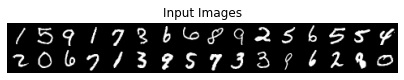

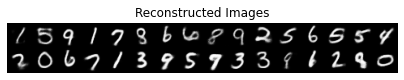

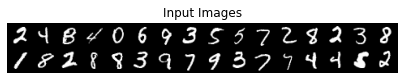

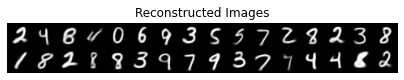

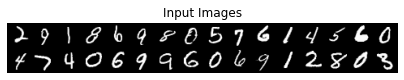

...

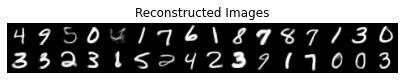

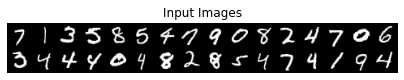

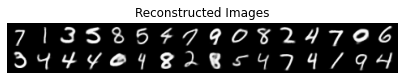

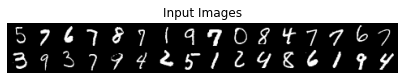

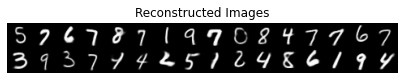

In [18]:
z_dim = 16
vae = train_model(epochs=10, z_dim=z_dim)

In [19]:
def visualize_latent_space(model, data_loader, device, method='TSNE', num_samples=10000):

    model.eval()
    latents = []
    labels = []

    with torch.no_grad():
        for i, (data, label) in enumerate(data_loader):
            if len(latents) > num_samples:
                break
            mu, _ = model.encoder(data.to(device))
            latents.append(mu.cpu())
            labels.append(label.cpu())
    
    latents = torch.cat(latents, dim=0).numpy()
    labels = torch.cat(labels, dim=0).numpy()
    assert method in ['TSNE', 'UMAP']

    if method == 'TSNE':
        tsne = TSNE(n_components=2)
        tsne_results = tsne.fit_transform(latents)
        fig = px.scatter(tsne_results, x=0, y=1, color=labels, labels={'color': 'label'})
        fig.update_layout(title='VAE Latent Space with TSNE', width=600, height=600)
    
    elif method == 'UMAP':
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(latents)
        fig = px.scatter(embedding, x=0, y=1, color=labels, labels={'color': 'labels'})
        fig.update_layout(title='VAE Latent Space with UMAP', width=600, height=600)
    
    fig.show()

In [20]:
visualize_latent_space(vae, train_loader, device=device, method='UMAP', num_samples=10000)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [21]:
visualize_latent_space(vae, train_loader, device=device, method='TSNE', num_samples=10000)

## Sampling

### Posterior

In [22]:
def posterior_sampling(model, data_loader, n_samples=25):
    model.eval()
    images, _ = next(iter(data_loader))
    images = images[:n_samples]
    with torch.no_grad():
        _, encoding_dist = model(images.to(device))
        input_sample = encoding_dist.sample()
        reconstructed_images = model.decoder(input_sample)
        show_images_grid(images, title='input samples')
        show_images_grid(reconstructed_images, title='reconstructed samples')

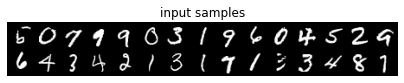

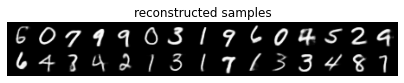

In [23]:
posterior_sampling(vae, train_loader, n_samples=30)

In [24]:
def prior_sampling(model, z_dim=32, n_samples=25):
  model.eval()
  input_sample = torch.randn(n_samples, z_dim)
  with torch.no_grad():
    sampled_images = model.decoder(input_sample)
  show_images_grid(sampled_images, title='Generated samples')

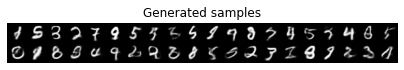

In [25]:
prior_sampling(vae, n_samples=20)

### Sampling from Class centers

In [26]:
def get_data_predictions(model, data_loader):
  model.eval()
  latents_mean = []
  latents_std = []
  labels = []

  with torch.no_grad():
    for i, (data, label) in enumerate(data_loader):
      mu, std = model.encoder(data.to(device))
      latents_mean.append(mu.cpu())
      latents_std.append(std.cpu())
      labels.append(label.cpu())

  latents_mean = torch.cat(latents_mean, dim=0)
  latents_std = torch.cat(latents_std, dim=0)
  labels = torch.cat(labels, dim=0)

  return latents_mean, latents_std, labels

In [27]:
def get_classes_mean(class_to_idx, labels, latents_mean, latents_std):
  classes_mean = {}

  for class_name in train_loader.dataset.class_to_idx:
    class_id = train_loader.dataset.class_to_idx[class_name]

    latents_mean_class = latents_mean[labels==class_id]
    latents_mean_class = latents_mean_class.mean(dim=0, keepdims=True)

    latents_std_class = latents_std[labels==class_id]
    latents_std_class = latents_std.mean(dim=0, keepdims=True)

    labels_class = labels[labels == class_id]

    classes_mean[class_id] = [latents_mean_class, latents_std_class]

  return classes_mean


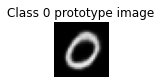

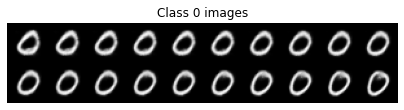

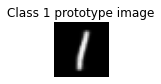

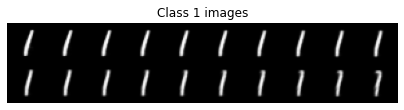

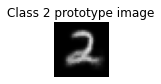

...

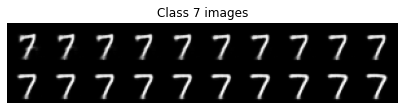

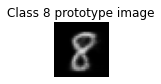

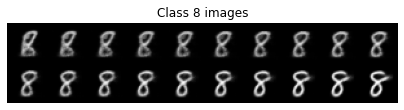

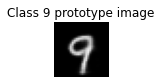

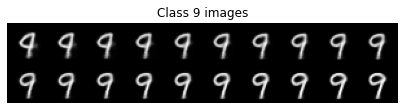

In [28]:
latents_mean, latents_stdvar, labels = get_data_predictions(vae, train_loader)
classes_mean = get_classes_mean(train_loader.dataset.class_to_idx, labels, latents_mean, latents_stdvar)
n_samples = 20

for class_id in classes_mean:
  latents_mean_class, latents_stddev_class = classes_mean[class_id]
  class_dist = Normal(latents_mean_class, latents_stddev_class)
  percentiles = torch.linspace(0.05, 0.95, n_samples)
  class_z_sample = class_dist.icdf(percentiles[:, None].repeat(1, z_dim))
  with torch.no_grad():
    class_image_prototype = vae.decoder(latents_mean_class.to(device))
    class_images = vae.decoder(class_z_sample.to(device))
    show_image(class_image_prototype[0].cpu(), title=f'Class {class_id} prototype image')
    show_images_grid(class_images.cpu(), title=f'Class {class_id} images')

### Linear Interpolation

In [29]:
def linear_interpolation(start, end, steps):
  z = torch.linspace(0, 1, steps)[:, None].to(device) * (end - start) + start
  vae.eval()
  with torch.no_grad():
    samples = vae.decoder(z)

  return samples

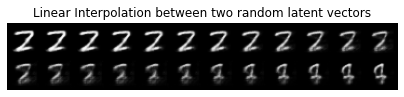

In [30]:
# Linear interpolation between two random latent vectors
start = torch.randn(1, z_dim).to(device)
end = torch.randn(1, z_dim).to(device)

interpolated_samples = linear_interpolation(start, end, steps=24)
show_images_grid(interpolated_samples, title=f'Linear Interpolation between two random latent vectors')

/var/folders/v8/l597fdmn691ctljk27sgct540000gn/T/ipykernel_41611/4233999083.py:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



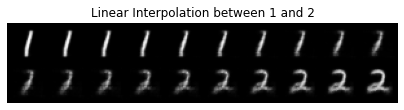

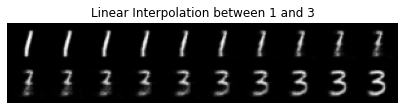

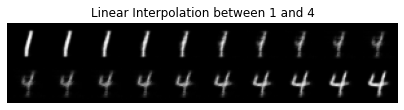

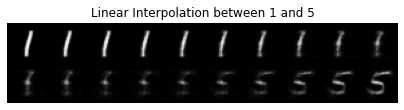

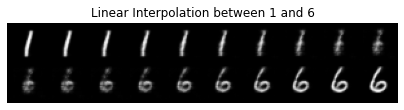

...

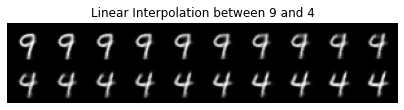

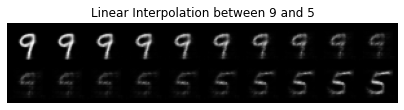

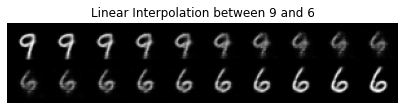

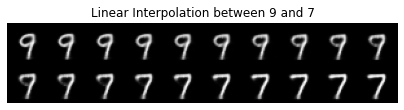

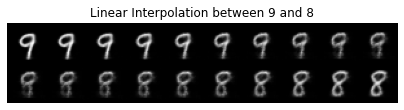

In [31]:
# Linear interpolation between all classes

for start_id in range(1, 10):
  start = classes_mean[start_id][0].to(device)

  for end_id in range(1, 10):
    if start_id == end_id:
      continue
    end = classes_mean[end_id][0].to(device)
    interpolated_samples = linear_interpolation(start, end, steps=20)
    show_images_grid(interpolated_samples, title=f'Linear Interpolation between {start_id} and {end_id}')

In [32]:
def latent_space_traversal(model, input_sample, norm_dist, dim_to_traverse, n_samples, latent_dim, device):
    # Create a range of values to traverse
    assert input_sample.shape[0] == 1, 'input sample shape should be [1, latent_dim]'
    # Generate linearly spaced percentiles between 0.05 and 0.95
    percentiles = torch.linspace(0.1, 0.9, n_samples)
    # Get the quantile values corresponding to the percentiles
    traversed_values = norm_dist.icdf(percentiles[:, None].repeat(1, latent_dim))
    # Initialize a latent space vector with zeros
    z = input_sample.repeat(n_samples, 1)
    # Assign the traversed values to the specified dimension
    z[:, dim_to_traverse] = traversed_values[:, dim_to_traverse]

    # Decode the latent vectors
    with torch.no_grad():
        samples = model.decoder(z.to(device))
    return samples

/var/folders/v8/l597fdmn691ctljk27sgct540000gn/T/ipykernel_41611/4233999083.py:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



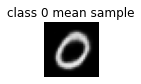

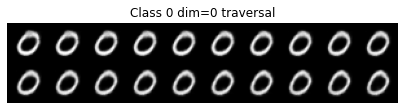

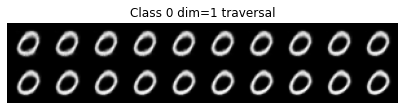

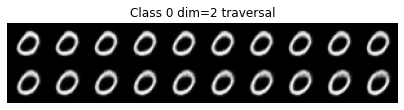

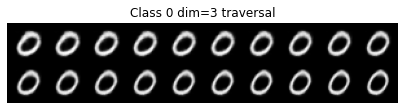

...

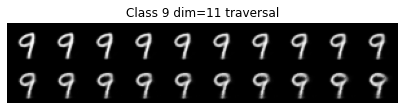

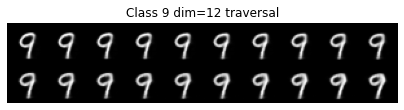

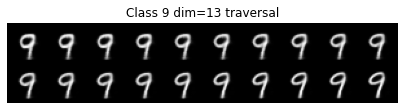

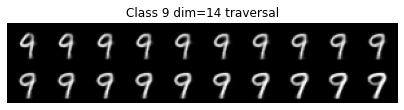

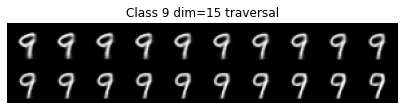

In [33]:
for class_id in range(0, 10):
  mu, std = classes_mean[class_id]
  with torch.no_grad():
    reconstructed_images = vae.decoder(mu.to(device))
  show_image(reconstructed_images[0], title=f'class {class_id} mean sample')
  for i in range(z_dim):
    interpolated_samples = latent_space_traversal(vae, mu, norm_dist=Normal(mu, torch.ones_like(mu)), dim_to_traverse=i, n_samples=20, latent_dim=z_dim, device=device)
    show_images_grid(interpolated_samples, title=f'Class {class_id} dim={i} traversal')

In [34]:
def traverse_two_latent_dimensions(model, input_sample, z_dist, n_samples=25, z_dim=16, dim_1=0, dim_2=1, title='plot'):
    digit_size = 28
    percentiles = torch.linspace(0.1, 0.9, n_samples)

    grid_x = z_dist.icdf(percentiles[:, None].repeat(1, z_dim))
    grid_y = z_dist.icdf(percentiles[:, None].repeat(1, z_dim))
    figure = np.zeros((digit_size * n_samples, digit_size * n_samples))

    z_sample_def = input_sample.clone().detach()

    for y_i in range(n_samples):
        for x_i in range(n_samples):
            with torch.no_grad():
                z_sample = z_sample_def.clone().detach()
                z_sample[:, dim_1] = grid_x[x_i, dim_1]
                z_sample[:, dim_2] = grid_y[y_i, dim_2]
                x_decoded = model.decoder(z_sample.to(device)).cpu()
            digit = x_decoded[0].reshape(digit_size, digit_size)
            figure[y_i * digit_size: (y_i + 1) * digit_size, x_i * digit_size: (x_i + 1) * digit_size] = digit.numpy()
    plt.figure(figsize=(12, 12))
    plt.imshow(figure, cmap='gray')
    plt.title(title)

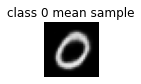

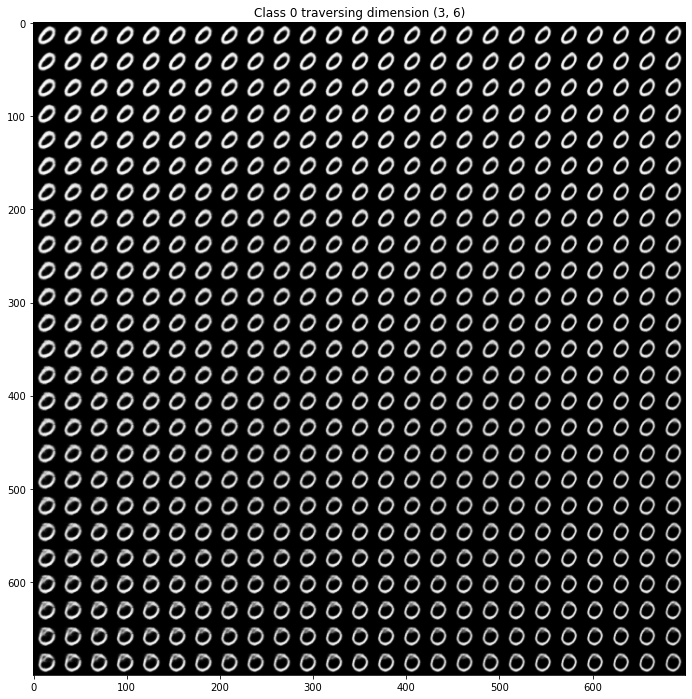

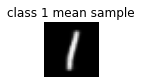

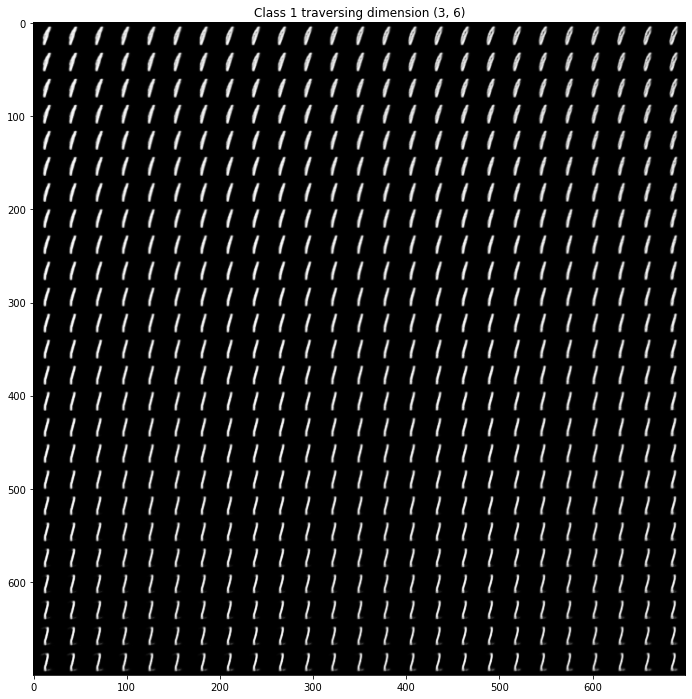

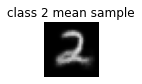

...

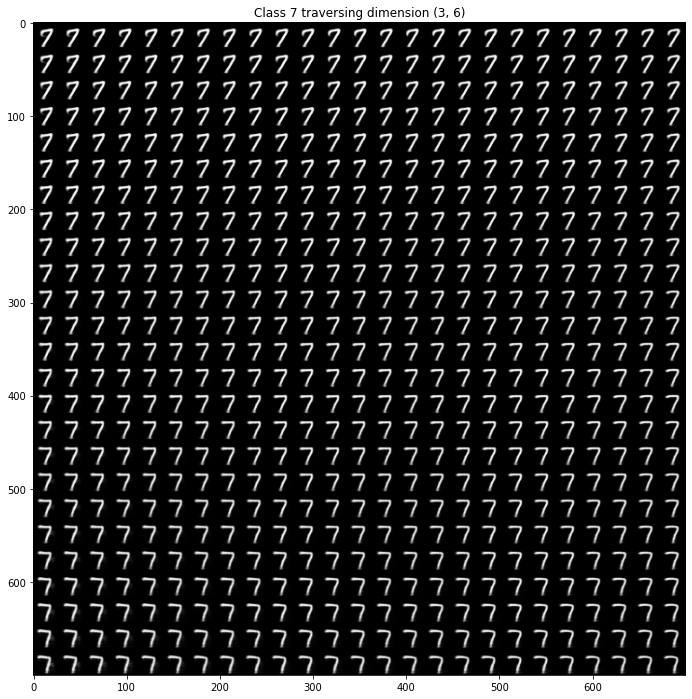

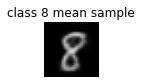

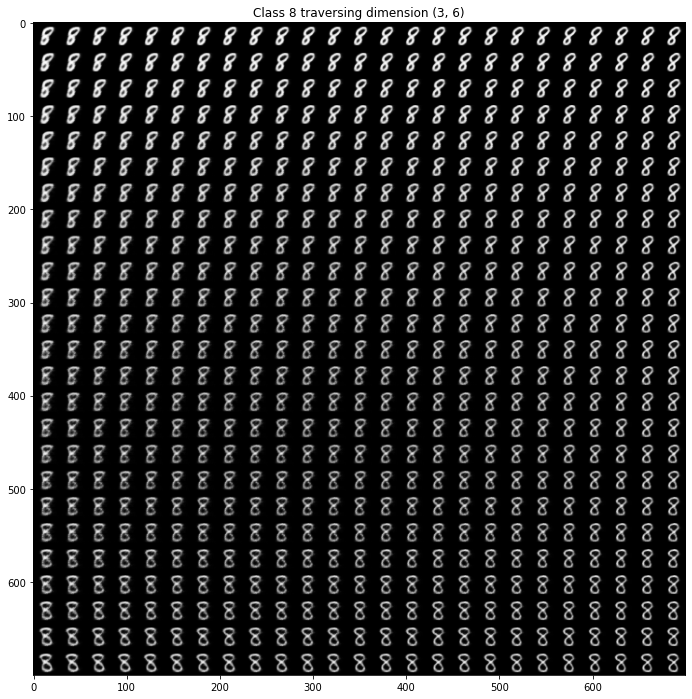

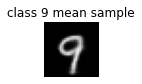

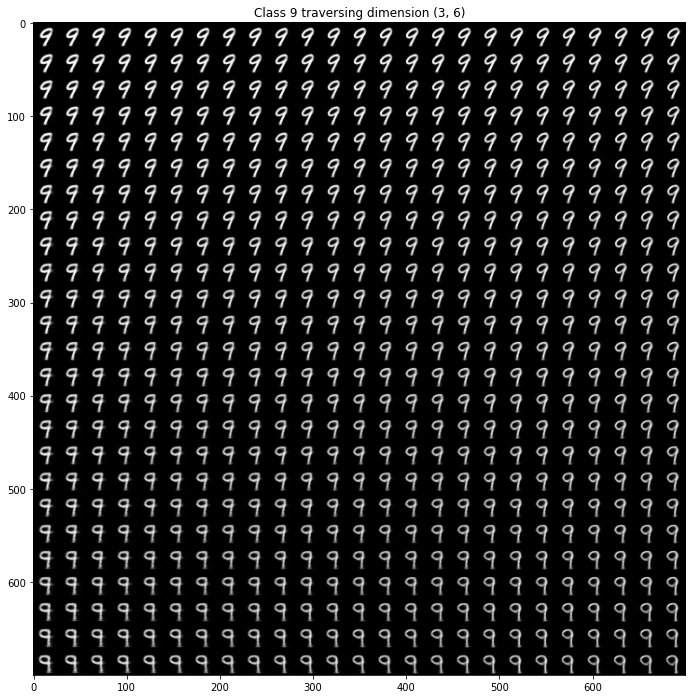

In [35]:
dim_1 = 3
dim_2 = 6
for class_id in range(10):
    mu, std = classes_mean[class_id]
    with torch.no_grad():
        reconstructed_images = vae.decoder(mu.to(device))
    show_image(reconstructed_images[0], title=f'class {class_id} mean sample')
    traverse_two_latent_dimensions(vae, mu, z_dist=Normal(mu, torch.ones_like(mu)), z_dim=z_dim, dim_1=dim_1, dim_2=dim_2, title=f'Class {class_id} traversing dimension {(dim_1, dim_2)}')

### 2D Manifold

Epoch 0


100%|██████████| 938/938 [01:03<00:00, 14.73it/s]


Epoch 1


100%|██████████| 938/938 [01:03<00:00, 14.79it/s]


Epoch 2


100%|██████████| 938/938 [01:03<00:00, 14.84it/s]


Epoch 3


100%|██████████| 938/938 [01:03<00:00, 14.85it/s]


Epoch 4


100%|██████████| 938/938 [01:02<00:00, 14.93it/s]


Epoch 5


100%|██████████| 938/938 [01:03<00:00, 14.80it/s]


Epoch 6


100%|██████████| 938/938 [01:02<00:00, 14.89it/s]


Epoch 7


100%|██████████| 938/938 [01:03<00:00, 14.76it/s]


Epoch 8


100%|██████████| 938/938 [01:03<00:00, 14.83it/s]


Epoch 9


100%|██████████| 938/938 [01:03<00:00, 14.84it/s]


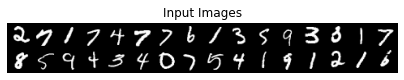

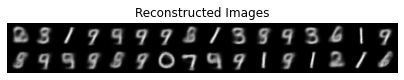

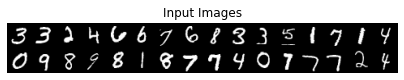

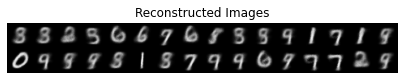

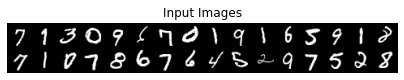

...

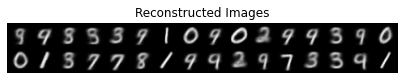

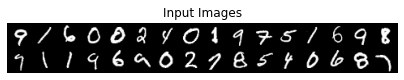

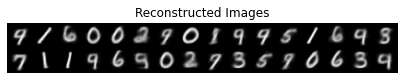

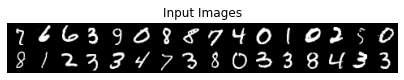

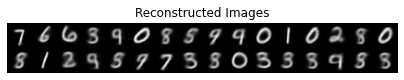

In [36]:
vae_2d = train_model(epochs=10, z_dim=2)

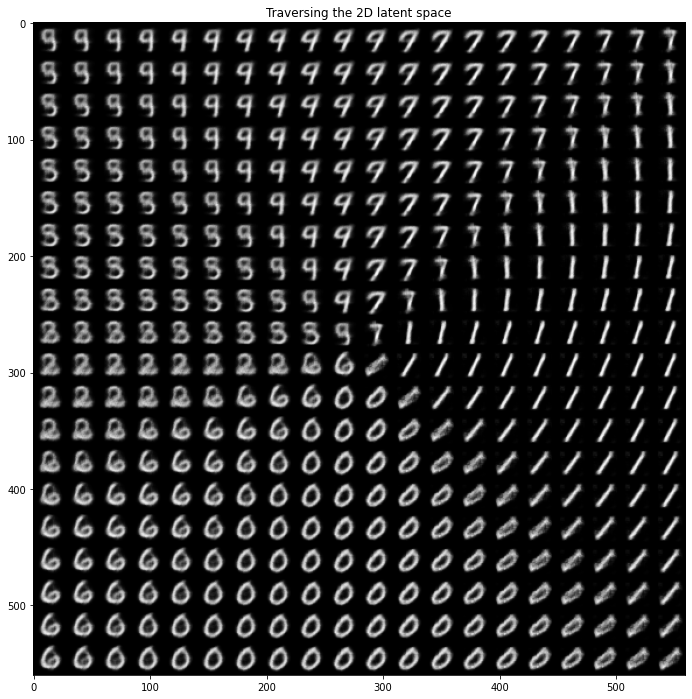

In [37]:
z_dist = Normal(torch.zeros(1, 2), torch.ones(1, 2))
input_sample = torch.zeros(1, 2)
with torch.no_grad():
    decoding = vae_2d.decoder(input_sample.to(device))

traverse_two_latent_dimensions(vae_2d, input_sample, z_dist, n_samples=20, dim_1=0, dim_2=1, z_dim=2, title=f'Traversing the 2D latent space')